<a href="https://colab.research.google.com/github/seunghwan1228/GAN/blob/master/Cycle_GAN_Vangogh.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [46]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_addons as tfa

import tqdm
import os
import warnings
from IPython.display import clear_output

warnings.filterwarnings('ignore')
tfds.disable_progress_bar()

In [3]:
# Get Dataset


datasets, info = tfds.load('cycle_gan/vangogh2photo', as_supervised=True, with_info=True)

Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/vangogh2photo/2.0.0.incomplete55JNJN/cycle_gan-trainA.tfrecord
Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/vangogh2photo/2.0.0.incomplete55JNJN/cycle_gan-trainB.tfrecord
Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/vangogh2photo/2.0.0.incomplete55JNJN/cycle_gan-testA.tfrecord
Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/vangogh2photo/2.0.0.incomplete55JNJN/cycle_gan-testB.tfrecord
Dataset cycle_gan downloaded and prepared to /root/tensorflow_datasets/cycle_gan/vangogh2photo/2.0.0. Subsequent calls will reuse this data.


In [4]:
datasets

{'testA': <DatasetV1Adapter shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>,
 'testB': <DatasetV1Adapter shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>,
 'trainA': <DatasetV1Adapter shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>,
 'trainB': <DatasetV1Adapter shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>}

In [6]:
# Define Data
# A: Paint
# B: Picture

train_a, train_b = datasets['trainA'], datasets['trainB']
test_a, test_b = datasets['testA'], datasets['testB']

In [7]:
# Resize - Random_flip - Normalize 
IMG_HEIGHT = 256
IMG_WIDTH = 256
BUFFER_SIZE = 1000


def random_crop_image(image):
  '''
  Crop Image
  '''
  cropped_image = tf.image.random_crop(image, size =(IMG_HEIGHT, IMG_WIDTH, 3))
  return cropped_image


def normalize_image(image):
  '''
  Normalize Image
  '''
  image = tf.cast(image, tf.float32)
  image = (image - 127.5) / 127.5
  return image


def resize_image(image):
  '''
  Resize Image
  '''
  image = tf.image.resize(image, size=(IMG_HEIGHT, IMG_WIDTH), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return image


def random_jitter(image):
  '''
  Resize as 286, 286
  Crop Image -> Random Horizontal Flip
  '''
  image = tf.image.resize(image, size=(286, 286), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  image = random_crop_image(image)
  image = tf.image.random_flip_left_right(image)
  return image

In [8]:
def process_train(image, label):
  image = random_jitter(image)
  image = normalize_image(image)
  return image

def process_test(image, label):
  image = resize_image(image)
  image = normalize_image(image)
  return image

In [9]:
def process_train(image, label):
  image = random_jitter(image)
  image = normalize_image(image)
  return image

def process_test(image, label):
  image = resize_image(image)
  image = normalize_image(image)
  return image

In [60]:
# Create Dataset
# Train Paint
train_paint = train_a.map(process_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_paint = train_paint.shuffle(BUFFER_SIZE).batch(16)

# Train Picture
train_picture = train_b.map(process_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_picture = train_picture.shuffle(BUFFER_SIZE).batch(16)


# Test Paint
test_paint = test_a.map(process_test, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_paint = test_paint.batch(16)

# Test Picture
test_picture = test_b.map(process_test, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_picture = test_picture.batch(16)

In [11]:
# Architecture - U-Net

# To Reduce Coding Time, Use Tutorial U-net
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to /tmp/pip-req-build-uv0aral6
  Running command git clone -q https://github.com/tensorflow/examples.git /tmp/pip-req-build-uv0aral6
  Created wheel for tensorflow-examples: filename=tensorflow_examples-4090ac205949af2f7b02d61012db7a66679818fc_-cp36-none-any.whl size=135403 sha256=d412fc1781009fd44736c5634a201feea75963a0fd04690c18e7619b403390ff
  Stored in directory: /tmp/pip-ephem-wheel-cache-zij_f5t4/wheels/83/64/b3/4cfa02dc6f9d16bf7257892c6a7ec602cd7e0ff6ec4d7d714d
Successfully built tensorflow-examples


In [12]:
from tensorflow_examples.models.pix2pix import pix2pix

In [ ]:
# Causion
# The Cycle GAN Requires to use Instance Normalization, Not Batch or Layer Normalization

OUTPUT_CHANNEL = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNEL, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNEL, norm_type='instancenorm')

discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)

discirminator_x

In [ ]:
# Define Optimizers

generator_g_optimizer = tf.keras.optimizers.Adam(1e-5, 0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(1e-5, 0.5)


discriminator_x_optimizer = tf.keras.optimizers.Adam(1e-5, 0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(1e-5, 0.5)

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)


def generator_loss(generated_output):
  return loss_object(tf.ones_like(generated_output), generated_output)


def discriminator_loss(real, generated):
  real_loss = loss_object(tf.ones_like(real), real)
  gen_loss = loss_object(tf.zeros_like(generated), generated)
  total_loss = real_loss + gen_loss * 0.5
  return total_loss


def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  return 10 * loss1


def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return 10 * 0.5 * loss

In [63]:
# Create Check point
checkpoint_path = 'checkpoint/train'

ckpt = tf.train.Checkpoint(generator_g = generator_g,
                           generator_f = generator_f,
                           discriminator_x = discriminator_x,
                           discriminator_y = discriminator_y,
                           generator_g_optimizer = generator_g_optimizer,
                           generator_f_optimizer = generator_f_optimizer,
                           discriminator_x_optimizer = discriminator_x_optimizer,
                           discriminator_y_optimizer = discriminator_y_optimizer)


checkpoint_prefix = 'ckpt'
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)


# TF summary writer
logdir = 'logdir'
summary_writer = tf.summary.create_file_writer(logdir)

In [64]:
@tf.function
def train_step(image_a, image_b):
  with tf.GradientTape(persistent=True) as tape:
    generate_b = generator_g(image_a, training=True)  
    generated_a = generator_f(image_b, training=True)

    cycled_a = generator_f(generate_b, training=True)
    cycled_b = generator_g(generated_a, training =True)


    disc_real_y = discriminator_y(image_b, training=True)
    disc_gen_y = discriminator_y(generate_b, training=True)

    disc_real_x = discriminator_x(image_a, training=True)
    disc_gen_x = discriminator_x(generated_a, training=True)

    same_b = generator_g(image_b, training = True)
    same_a = generator_f(image_a, training = True)

    # Calc Loss
    generator_g_loss = generator_loss(disc_gen_y)
    generator_f_loss = generator_loss(disc_gen_x)

    total_cycle_loss = calc_cycle_loss(image_a, cycled_a) + calc_cycle_loss(image_b, cycled_b)
    
    total_gen_g_loss = generator_g_loss + total_cycle_loss + identity_loss(image_b, same_b)
    total_gen_f_loss = generator_f_loss + total_cycle_loss + identity_loss(image_a, same_a)

    disc_y_loss = discriminator_loss(disc_real_y, disc_gen_y)
    disc_x_loss = discriminator_loss(disc_real_x, disc_gen_x)

  generator_g_gradient = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
  generator_f_gradient = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
  discriminator_x_gradient = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
  discriminator_y_gradient = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

  generator_g_optimizer.apply_gradients(zip(generator_g_gradient, generator_g.trainable_variables))
  generator_f_optimizer.apply_gradients(zip(generator_f_gradient, generator_f.trainable_variables))
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradient, discriminator_x.trainable_variables))
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradient, discriminator_y.trainable_variables))

  return (generate_b, cycled_a)


In [65]:
%reload_ext tensorboard
%tensorboard --logdir {logdir}

<IPython.core.display.Javascript object>

In [66]:
def train_cycle_gan(x_data, y_data, epochs):
  '''
  x_data = picture data
  y_data = paint data
  '''
  dataset = tf.data.Dataset.zip((x_data, y_data))

  for epoch in tqdm.tqdm_notebook(range(epochs)):
    print(f'Epoch {epoch+1}')
    for n, (paint_data, picture_data) in enumerate(dataset): 
      generated_paint, cycled_paint = train_step(paint_data, picture_data)

      if n % 10 == 0:
        print('.', end='')

    if (epoch+1) % 2 == 0:
      clear_output(wait=True)
      test_input = next(iter(test_paint))
      test_input_res = (test_input.numpy()[0] * 0.5) + 0.5

      test_img = generator_g(test_input)
      test_img = (test_img * 0.5) + 0.5
      test_img = test_img.numpy()[0]
      
      # Plotting 
      plt.figure(figsize=(8,8))
      plt.subplot(1, 2, 1)
      plt.title('Original Input')
      plt.imshow(test_input_res)
      plt.subplot(1, 2, 2)
      plt.title('Generator G Ouput')
      plt.imshow(test_img)
      plt.show()
    
    if (epoch+1) % 20 == 0:
      ckpt_manager.save()
          
    with summary_writer.as_default():
      tf.summary.image('Genrated Img', (generated_paint * 0.5) + 0.5, step=epoch, max_outputs=5)
      tf.summary.image('Cycled Img', (cycled_paint * 0.5) + 0.5, step=epoch, max_outputs=5)


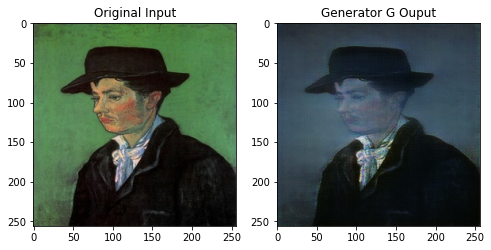

In [67]:
train_cycle_gan(train_paint, train_picture, 600)

# Run 3 Times

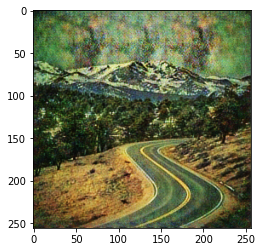

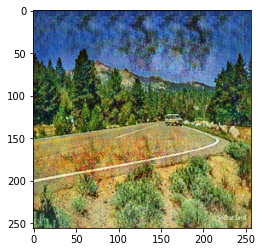

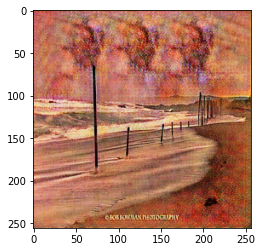

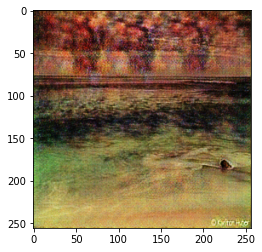

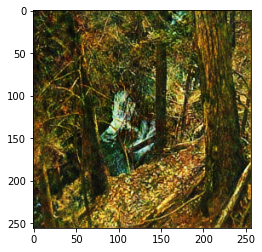

...

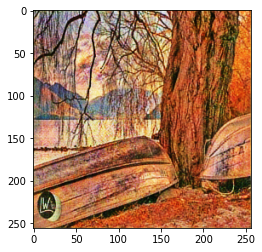

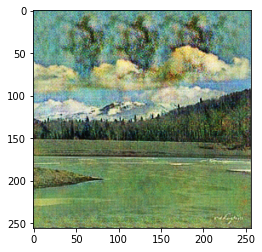

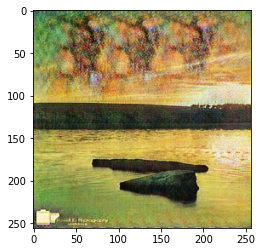

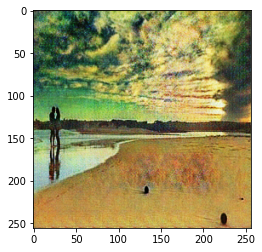

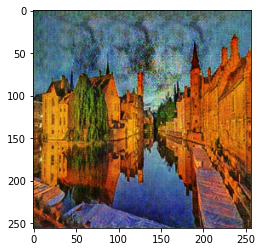

In [76]:
for i in test_picture.take(15):
  plt.figure()
  img = generator_f(tf.expand_dims(i[0], 0))
  img = img.numpy() * 0.5 + 0.5
  plt.imshow(img[0])

In [77]:
!pip install gradio

     |████████████████████████████████| 1.4MB 8.7MB/s 
     |████████████████████████████████| 215kB 56.7MB/s 
     |████████████████████████████████| 962kB 54.4MB/s 
     |████████████████████████████████| 2.7MB 56.9MB/s 
     |████████████████████████████████| 61kB 8.9MB/s 


In [78]:
import gradio as gr

In [84]:
def process_test(image):
  image = resize_image(image)
  image = normalize_image(image)
  return image


def gradio_run(img):
  img = process_test(img)
  img = generator_f(tf.expand_dims(img, 0))
  img = img.numpy() * 0.5 + 0.5
  return img[0]

In [86]:
gr.Interface(gradio_run, inputs='image', outputs='image', verbose=True).launch()

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on External URL: https://27593.gradio.app
Cannot display local interface on google colab, public link created.
Interface loading below...


(<gradio.networking.serve_files_in_background.<locals>.HTTPServer at 0x7f50199e89e8>,
 'http://127.0.0.1:7862/',
 'https://27593.gradio.app')